In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

import warnings 
warnings.filterwarnings('ignore')

In [2]:
df = pd.read_csv('../data/union_DIM_TIENDA_Meta_venta.csv')
df.head()

,TIENDA_ID,PLAZA_CVE,NIVELSOCIOECONOMICO_DES,ENTORNO_DES,MTS2VENTAS_NUM,PUERTASREFRIG_NUM,CAJONESESTACIONAMIENTO_NUM,LATITUD_NUM,LONGITUD_NUM,SEGMENTO_MAESTRO_DESC,LID_UBICACION_TIENDA,MES_ID,VENTA_TOTAL,TARGET
0,126,1,BC,HOGAR,127.42,13,7,25.69107,-100.21261,HOGAR REUNIÓN,UT_DENSIDAD,202406,78331.04,0
1,126,1,BC,HOGAR,127.42,13,7,25.69107,-100.21261,HOGAR REUNIÓN,UT_DENSIDAD,202402,984454.29,1
2,126,1,BC,HOGAR,127.42,13,7,25.69107,-100.21261,HOGAR REUNIÓN,UT_DENSIDAD,202307,1096866.62,1
3,126,1,BC,HOGAR,127.42,13,7,25.69107,-100.21261,HOGAR REUNIÓN,UT_DENSIDAD,202310,775114.25,1
4,126,1,BC,HOGAR,127.42,13,7,25.69107,-100.21261,HOGAR REUNIÓN,UT_DENSIDAD,202304,1095804.32,1


In [3]:
print("\nDimensiones del DataFrame (filas, columnas):")
print(df.shape)


Dimensiones del DataFrame (filas, columnas):
(19253, 14)


In [4]:
print("\nInformación general del DataFrame:")
df.info()


Información general del DataFrame:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 19253 entries, 0 to 19252
Data columns (total 14 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   TIENDA_ID                   19253 non-null  int64  
 1   PLAZA_CVE                   19253 non-null  int64  
 2   NIVELSOCIOECONOMICO_DES     19253 non-null  object 
 3   ENTORNO_DES                 19253 non-null  object 
 4   MTS2VENTAS_NUM              19253 non-null  float64
 5   PUERTASREFRIG_NUM           19253 non-null  int64  
 6   CAJONESESTACIONAMIENTO_NUM  19253 non-null  int64  
 7   LATITUD_NUM                 19253 non-null  float64
 8   LONGITUD_NUM                19253 non-null  float64
 9   SEGMENTO_MAESTRO_DESC       19253 non-null  object 
 10  LID_UBICACION_TIENDA        19253 non-null  object 
 11  MES_ID                      19253 non-null  int64  
 12  VENTA_TOTAL                 19253 non-null  float64


In [5]:
# Convierte las columnas object a tipo 'category'
cols_to_category = [
    'NIVELSOCIOECONOMICO_DES',
    'ENTORNO_DES',
    'SEGMENTO_MAESTRO_DESC',
    'LID_UBICACION_TIENDA',
    'TARGET' 
]

for col in cols_to_category:
    if col in df.columns: # Asegúrate de que la columna exista
        df[col] = df[col].astype('category')
        print(f"Columna '{col}' convertida a 'category'.")

# Verifica nuevamente los tipos de datos
print("\nTipos de datos después de la conversión:")
print(df.info())

Columna 'NIVELSOCIOECONOMICO_DES' convertida a 'category'.
Columna 'ENTORNO_DES' convertida a 'category'.
Columna 'SEGMENTO_MAESTRO_DESC' convertida a 'category'.
Columna 'LID_UBICACION_TIENDA' convertida a 'category'.
Columna 'TARGET' convertida a 'category'.

Tipos de datos después de la conversión:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 19253 entries, 0 to 19252
Data columns (total 14 columns):
 #   Column                      Non-Null Count  Dtype   
---  ------                      --------------  -----   
 0   TIENDA_ID                   19253 non-null  int64   
 1   PLAZA_CVE                   19253 non-null  int64   
 2   NIVELSOCIOECONOMICO_DES     19253 non-null  category
 3   ENTORNO_DES                 19253 non-null  category
 4   MTS2VENTAS_NUM              19253 non-null  float64 
 5   PUERTASREFRIG_NUM           19253 non-null  int64   
 6   CAJONESESTACIONAMIENTO_NUM  19253 non-null  int64   
 7   LATITUD_NUM                 19253 non-null  float64 
 8   LON

In [6]:
print("\nEstadísticas descriptivas para columnas numéricas:")
print(df.describe())


Estadísticas descriptivas para columnas numéricas:
          TIENDA_ID     PLAZA_CVE  MTS2VENTAS_NUM  PUERTASREFRIG_NUM  \
count  19253.000000  19253.000000    19253.000000       19253.000000   
mean     516.799927      3.422895       81.242212           9.767828   
std      304.352007      1.751358       50.380126           4.819925   
min        1.000000      1.000000        0.000000           0.000000   
25%      255.000000      2.000000        0.000000          10.000000   
50%      509.000000      3.000000      103.600000          12.000000   
75%      765.000000      5.000000      115.550000          13.000000   
max     1056.000000      6.000000      214.200000          18.000000   

       CAJONESESTACIONAMIENTO_NUM   LATITUD_NUM  LONGITUD_NUM         MES_ID  \
count                19253.000000  19253.000000  19253.000000   19253.000000   
mean                     4.169948     25.687669    -99.660877  202350.033449   
std                      4.736107      0.740049      2.7972

In [7]:
print("\nEstadísticas descriptivas para columnas categóricas:")
print(df.describe(include='category'))


Estadísticas descriptivas para columnas categóricas:
       NIVELSOCIOECONOMICO_DES ENTORNO_DES SEGMENTO_MAESTRO_DESC  \
count                    19253       19253                 19253   
unique                       7           4                     5   
top                          C       HOGAR         HOGAR REUNIÓN   
freq                     13424       11681                 12465   

       LID_UBICACION_TIENDA  TARGET  
count                 19253   19253  
unique                    5       2  
top             UT_DENSIDAD       1  
freq                  10738   17869  


In [8]:
for col in cols_to_category:
    if col in df.columns:
        print(f"\nDistribución de la columna '{col}':")
        print(df[col].value_counts())
        print(f"Porcentajes de la columna '{col}':")
        print(df[col].value_counts(normalize=True) * 100)


Distribución de la columna 'NIVELSOCIOECONOMICO_DES':
NIVELSOCIOECONOMICO_DES
C     13424
B      1865
BC     1532
CD     1280
AB      649
D       336
A       167
Name: count, dtype: int64
Porcentajes de la columna 'NIVELSOCIOECONOMICO_DES':
NIVELSOCIOECONOMICO_DES
C     69.724199
B      9.686802
BC     7.957201
CD     6.648315
AB     3.370903
D      1.745183
A      0.867397
Name: proportion, dtype: float64

Distribución de la columna 'ENTORNO_DES':
ENTORNO_DES
HOGAR       11681
BASE         4610
RECESO       2834
PEATONAL      128
Name: count, dtype: int64
Porcentajes de la columna 'ENTORNO_DES':
ENTORNO_DES
HOGAR       60.671064
BASE        23.944320
RECESO      14.719784
PEATONAL     0.664831
Name: proportion, dtype: float64

Distribución de la columna 'SEGMENTO_MAESTRO_DESC':
SEGMENTO_MAESTRO_DESC
HOGAR REUNIÓN       12465
PARADA TÉCNICA       2886
OFICINISTAS          1977
CLÁSICO              1389
BARRIO COMPETIDO      536
Name: count, dtype: int64
Porcentajes de la columna 'SEGM

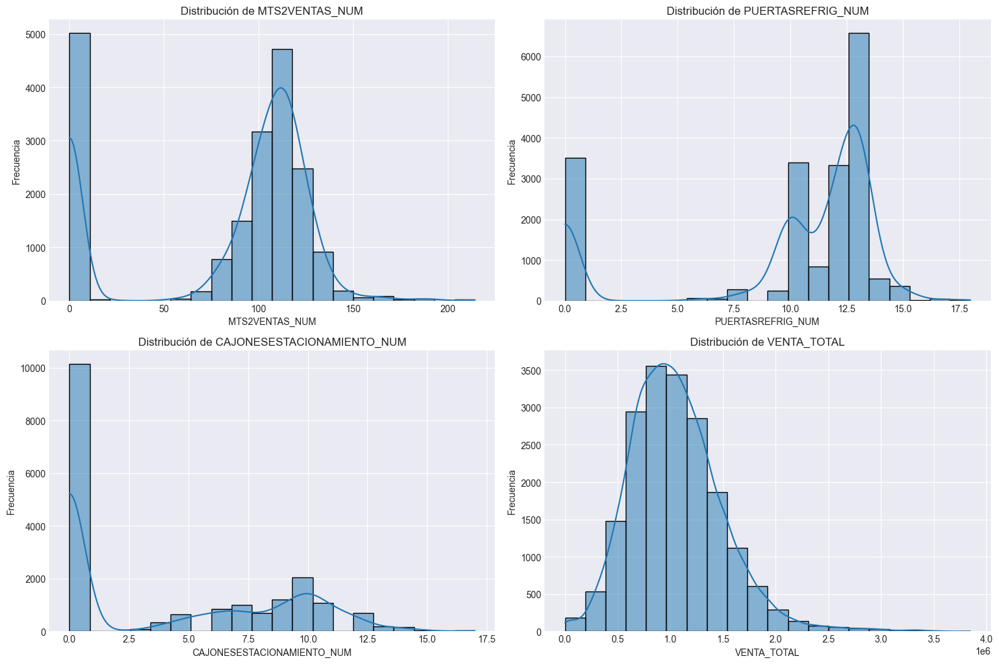

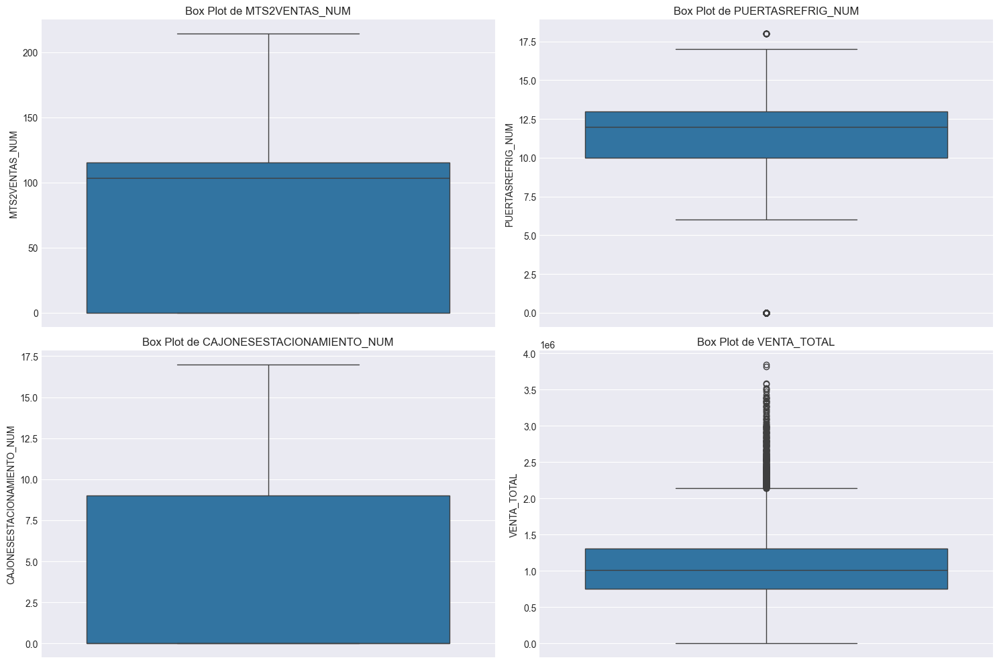

In [9]:
plt.style.use('seaborn-v0_8-darkgrid') 
%matplotlib inline

numeric_cols = [
    'MTS2VENTAS_NUM',
    'PUERTASREFRIG_NUM',
    'CAJONESESTACIONAMIENTO_NUM',
    'VENTA_TOTAL'
]

plt.figure(figsize=(15, 10))
for i, col in enumerate(numeric_cols):
    plt.subplot(2, 2, i+1) # 2 filas, 2 columnas de gráficos
    sns.histplot(df[col], kde=True, bins=20)
    plt.title(f'Distribución de {col}')
    plt.xlabel(col)
    plt.ylabel('Frecuencia')
plt.tight_layout()
plt.show()

plt.figure(figsize=(15, 10))
for i, col in enumerate(numeric_cols):
    plt.subplot(2, 2, i+1)
    sns.boxplot(y=df[col])
    plt.title(f'Box Plot de {col}')
    plt.ylabel(col)
plt.tight_layout()
plt.show()

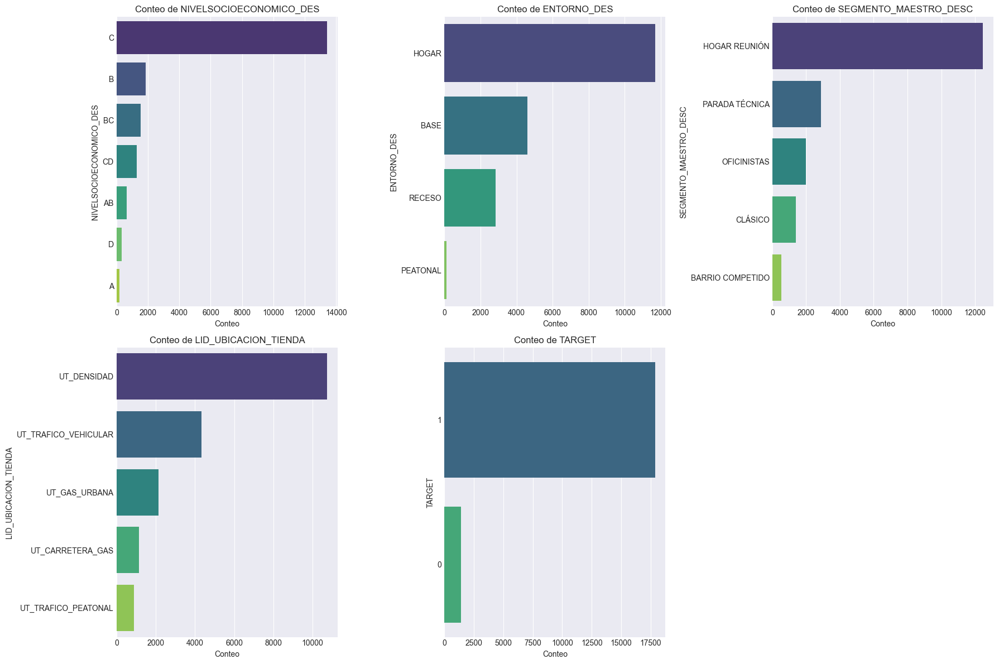

In [10]:
plt.figure(figsize=(18, 12))
for i, col in enumerate(cols_to_category): # Añadir TARGET si es categórica (0/1)
    plt.subplot(2, 3, i+1) # Ajusta el grid según el número de columnas
    sns.countplot(y=df[col], order=df[col].value_counts().index, palette='viridis')
    plt.title(f'Conteo de {col}')
    plt.xlabel('Conteo')
    plt.ylabel(col)
plt.tight_layout()
plt.show()

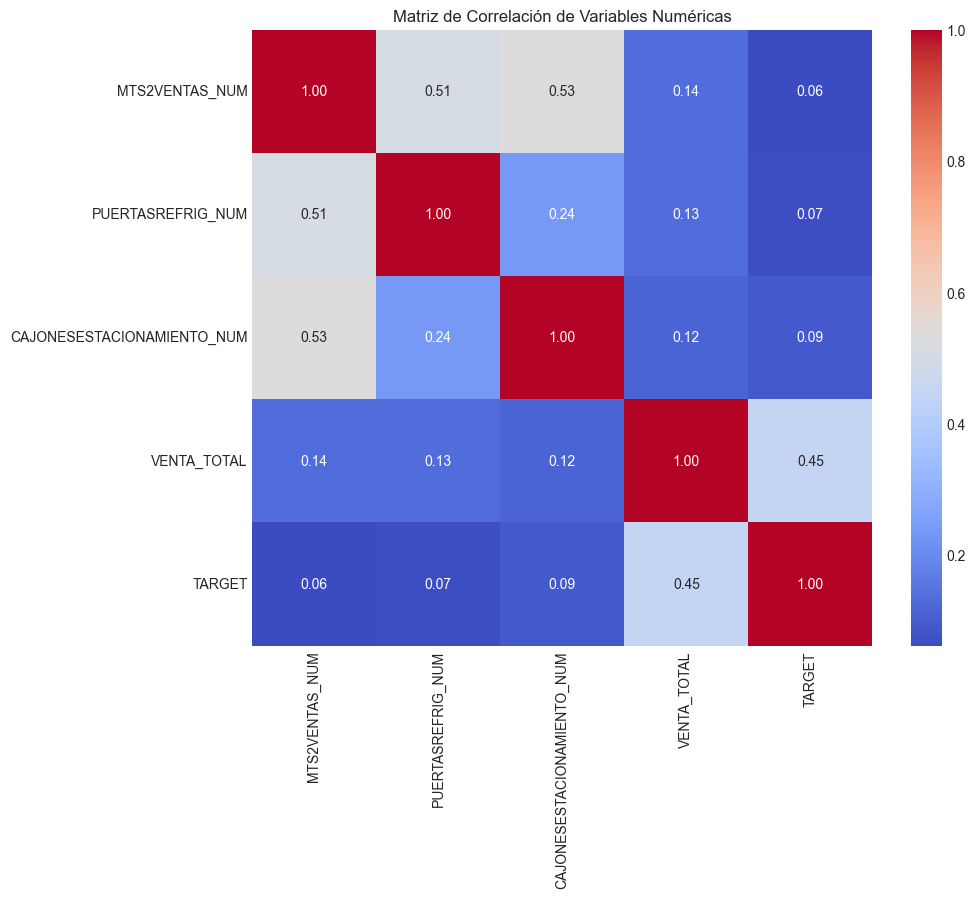

In [11]:
correlation_matrix = df[numeric_cols + ['TARGET']].corr()
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Matriz de Correlación de Variables Numéricas')
plt.show()

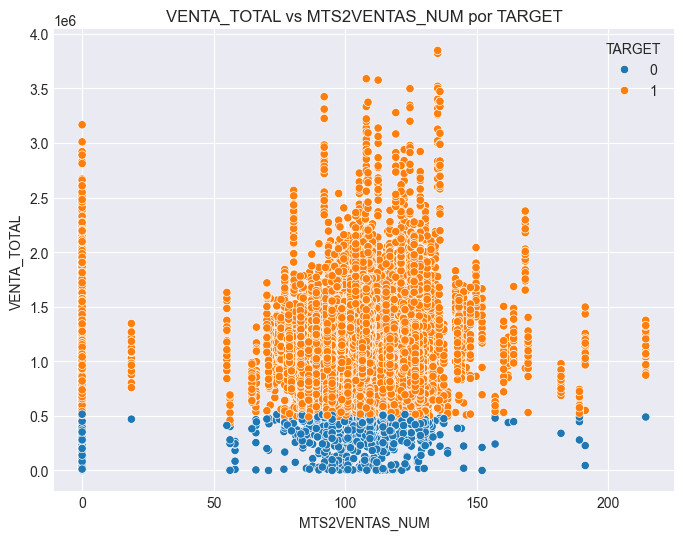

In [12]:
plt.figure(figsize=(8, 6))
sns.scatterplot(x='MTS2VENTAS_NUM', y='VENTA_TOTAL', hue='TARGET', data=df)
plt.title('VENTA_TOTAL vs MTS2VENTAS_NUM por TARGET')
plt.xlabel('MTS2VENTAS_NUM') # ¡Aquí está la corrección!
plt.ylabel('VENTA_TOTAL')
plt.show()

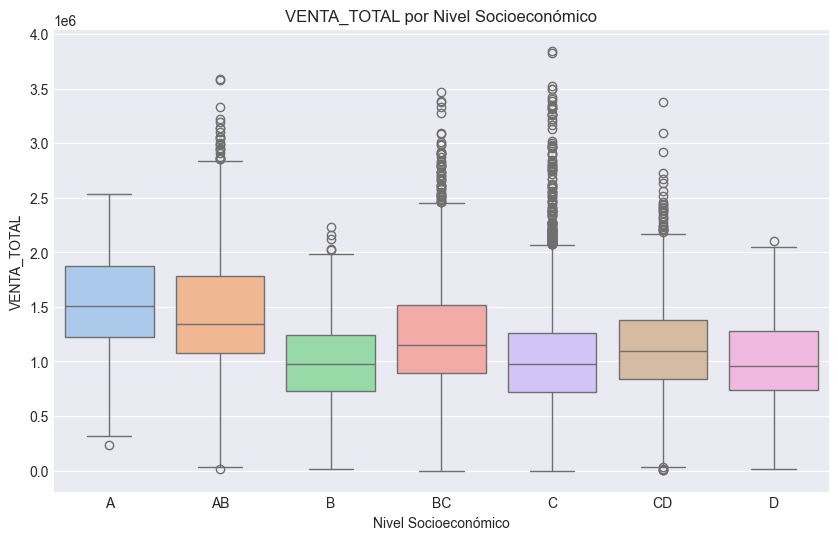

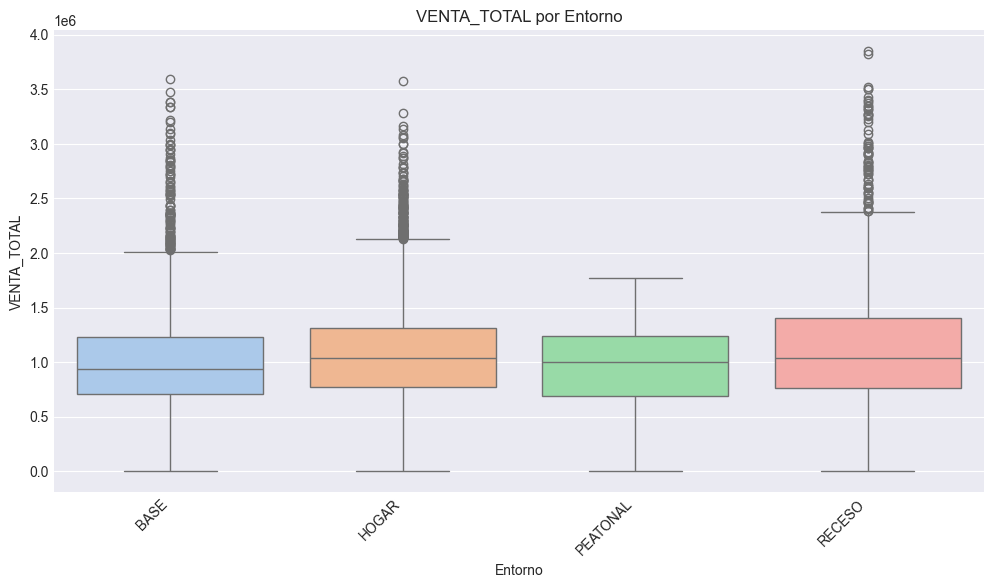

In [13]:
# Ejemplo: VENTA_TOTAL por NIVELSOCIOECONOMICO_DES
plt.figure(figsize=(10, 6))
sns.boxplot(x='NIVELSOCIOECONOMICO_DES', y='VENTA_TOTAL', data=df, palette='pastel')
plt.title('VENTA_TOTAL por Nivel Socioeconómico')
plt.xlabel('Nivel Socioeconómico')
plt.ylabel('VENTA_TOTAL')
plt.show()

# Ejemplo: VENTA_TOTAL por ENTORNO_DES
plt.figure(figsize=(12, 6))
sns.boxplot(x='ENTORNO_DES', y='VENTA_TOTAL', data=df, palette='pastel')
plt.title('VENTA_TOTAL por Entorno')
plt.xlabel('Entorno')
plt.ylabel('VENTA_TOTAL')
plt.xticks(rotation=45, ha='right')
plt.show()

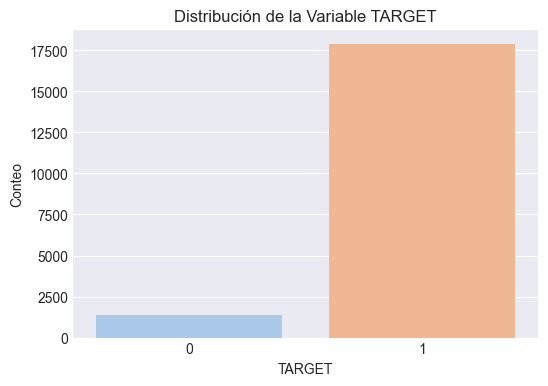


Porcentaje de cada clase en TARGET:
TARGET
1    92.81151
0     7.18849
Name: proportion, dtype: float64


In [14]:
plt.figure(figsize=(6, 4))
sns.countplot(x='TARGET', data=df, palette='pastel')
plt.title('Distribución de la Variable TARGET')
plt.xlabel('TARGET')
plt.ylabel('Conteo')
plt.show()

print("\nPorcentaje de cada clase en TARGET:")
print(df['TARGET'].value_counts(normalize=True) * 100)

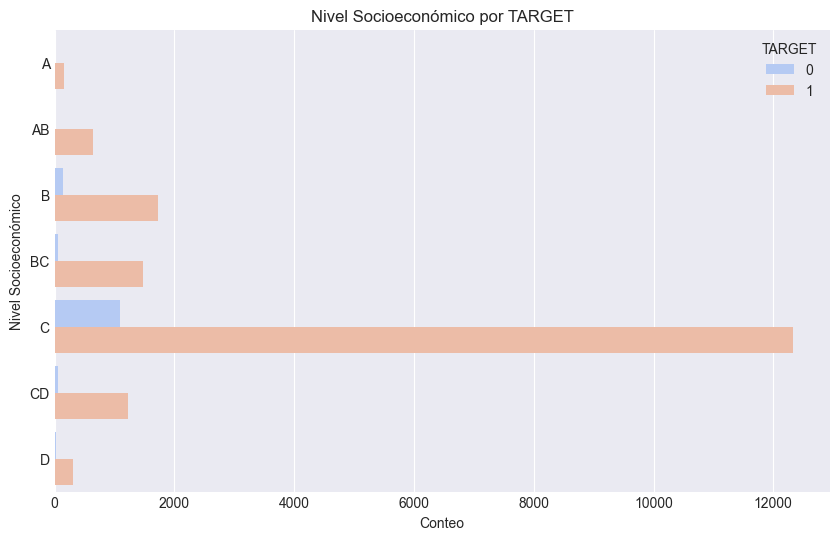

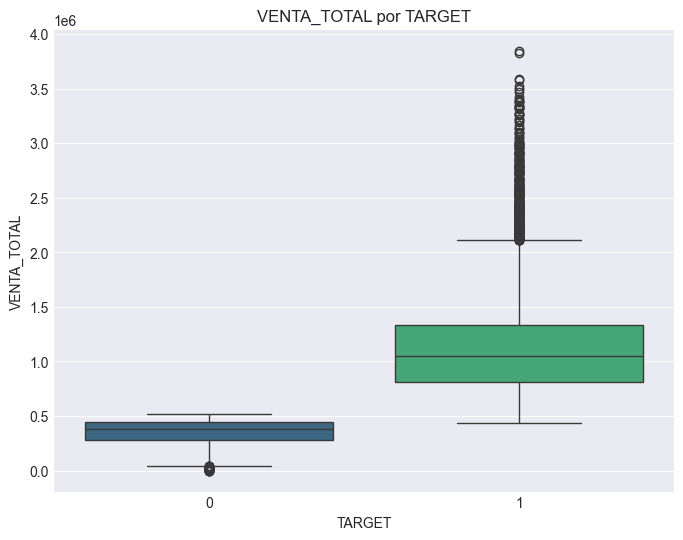

In [15]:
# Ejemplo: Nivel Socioeconómico por TARGET
plt.figure(figsize=(10, 6))
sns.countplot(y='NIVELSOCIOECONOMICO_DES', hue='TARGET', data=df, palette='coolwarm')
plt.title('Nivel Socioeconómico por TARGET')
plt.xlabel('Conteo')
plt.ylabel('Nivel Socioeconómico')
plt.show()

# Ejemplo: Box plot de VENTA_TOTAL por TARGET
plt.figure(figsize=(8, 6))
sns.boxplot(x='TARGET', y='VENTA_TOTAL', data=df, palette='viridis')
plt.title('VENTA_TOTAL por TARGET')
plt.xlabel('TARGET')
plt.ylabel('VENTA_TOTAL')
plt.show()

In [16]:
import folium
m = folium.Map(location=[df['LATITUD_NUM'].mean(), df['LONGITUD_NUM'].mean()], zoom_start=10)
for index, row in df.iterrows():
    folium.Marker([row['LATITUD_NUM'], row['LONGITUD_NUM']], popup=f"Tienda ID: {row['TIENDA_ID']}").add_to(m)
m.save('mapa_tiendas.html') # Guarda el mapa en un archivo HTML
m # Para mostrarlo directamente en Jupyter Notebook